In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import glob
import os
import peakutils
import logging
import datetime
import warnings
from lmfit.models import PseudoVoigtModel, GaussianModel
from jupyterthemes import jtplot
from matplotlib.colors import Normalize

In [2]:
from xps.xps_sw import *
from xps.xps_import import *
from xps.xps_analysis import *
from xps.xps_bg import *
from xps.xps_fits import *

jtplot.style('grade3', context='talk', grid=False, ticks=True, fscale=1.5)
logging.getLogger().setLevel(logging.CRITICAL)
warnings.filterwarnings("ignore")

In [696]:
dnames = {i: xp.name for i, xp in enumerate(experiments)}

# Correct overview_HD import

In [984]:
file = '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/20220822_ITO_G2SL_subl_72min.xy'
group = import_group_xp(file)

In [26]:
filescan = '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/BOLD131_C1_spatial/20220922_ITO_BOLD_131C1_3gota_100grad_air_anneal2.xy'
xps_data_import(filescan).dfx

range         Na1s             C1s          Na1s_(4)          C1s_(4)          \
properties  energy   counts energy   counts   energy   counts  energy  counts   
0           1085.0  7973.75  295.0   887.50   1075.0  1261.25   291.0  391.25   
1           1084.9  8067.50  294.9   991.25   1074.9  1282.50   290.9  436.25   
2           1084.8  7940.00  294.8  1003.75   1074.8  1283.75   290.8  358.75   
3           1084.7  8000.00  294.7  1006.25   1074.7  1353.75   290.7  391.25   
4           1084.6  7856.25  294.6   962.50   1074.6  1258.75   290.6  401.25   
..             ...      ...    ...      ...      ...      ...     ...     ...   
196         1065.4  6131.25    NaN      NaN      NaN      NaN     NaN     NaN   
197         1065.3  6098.75    NaN      NaN      NaN      NaN     NaN     NaN   
198         1065.2  6156.25    NaN      NaN      NaN      NaN     NaN     NaN   
199         1065.1  6118.75    NaN      NaN      NaN      NaN     NaN     NaN   
200         1065.0  6092.50    NaN      NaN      NaN      NaN     NaN     NaN   

range      Na1s_(2)          ...    Na1s             C1s           In3d  \
properties   energy  counts  ...  energy   counts energy  counts energy   
0            1075.0  871.25  ...  1075.0  2068.25  291.0   814.0  449.0   
1            1074.9  836.25  ...  1074.9  2070.75  290.9   789.5  448.9   
2            1074.8  782.50  ...  1074.8  2084.00  290.8   825.0  448.8   
3            1074.7  762.50  ...  1074.7  2047.50  290.7  1034.0  448.7   
4            1074.6  852.50  ...  1074.6  2066.00  290.6   819.0  448.6   
..              ...     ...  ...     ...      ...    ...     ...    ...   
196             NaN     NaN  ...     NaN      NaN    NaN     NaN    NaN   
197             NaN     NaN  ...     NaN      NaN    NaN     NaN    NaN   
198             NaN     NaN  ...     NaN      NaN    NaN     NaN    NaN   
199             NaN     NaN  ...     NaN      NaN    NaN     NaN    NaN   
200             NaN     NaN  ...     NaN      NaN    NaN     NaN    NaN   

range                 Na1s             C1s         
properties  counts  energy   counts energy counts  
0           1378.0  1075.0  2070.50  291.0  884.0  
1           1351.0  1074.9  2125.25  290.9  855.0  
2           1433.0  1074.8  2080.25  290.8  841.0  
3           1423.0  1074.7  2088.25  290.7  826.0  
4           1404.0  1074.6  2075.00  290.6  851.0  
..             ...     ...      ...    ...    ...  
196            NaN     NaN      NaN    NaN    NaN  
197            NaN     NaN      NaN    NaN    NaN  
198            NaN     NaN      NaN    NaN    NaN  
199            NaN     NaN      NaN    NaN    NaN  
200            NaN     NaN      NaN    NaN    NaN  

[201 rows x 62 columns]

In [7]:
def sort_group_xp(group: list):
    """Search for overview_HD group and merge in main group"""
    if 'overview' in group[1].name:
        print('Merging groups, overview_HD found')
        group[1].dfx.rename(columns={'overview':'overview_HD'}, inplace=True)
        for r in group[1].dfx.columns.levels[0]:
            print(r)
            insert_dfx_region(group[0], group[1], region=r, inplace=True)
        
        return group[0].dfx
    else:
        print('Found zy scanning group or other pattern, import separately ', os.path.split(group[0].path)[1] )
        print([xp.name for xp in group])
        raise TypeError

In [8]:
def xps_data_import(path : str, name : str = None, label : str = None, color: str = None) -> XPS_experiment:
    """Method to arrange a XPS_experiment data"""
    import re
    delimiters = xy_region_delimiters(path)
    skipRows0, nrows0, regions = delimiters[:]
    dfx = import_single_df(path, skipRows0, nrows0, regions)

    try:
        if check_arrays(dfx[delimiters[2][0]]):
            hv = excitation_energy_metadata(path, delimiters[2][0])
            dfx = ke_to_be(dfx, hv)
    except ValueError:
        group = import_group_xp(path)
        dfx = sort_group_xp(group)  # Search for overview_HD

    relpath, filename = os.path.split(path)
    dir_name = os.path.split(relpath)[1]
    da = re.search('\d+_', filename).group(0).replace('/', '').replace('_', '')
    if da[:4] != '2020':
        date = re.sub('(\d{4})(\d{2})(\d{2})', r"\1.\2.\3", da, flags=re.DOTALL)
    else:
        date = re.sub('(\d{2})(\d{2})(\d{4})', r"\1.\2.\3", da, flags=re.DOTALL)

    other_meta = filename.replace(da, '')[1:].strip('.xy')
    if name == None: name = other_meta
    if label == None: label = da+'_'+other_meta

    return XPS_experiment(path = path, dfx = dfx, delimiters = delimiters, color = color,
                          name = name, label = label, date = date, other_meta = other_meta, fit={})

In [983]:
globpath = '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/**/'

files = glob.glob(globpath+'/*.xy', recursive=True)
files.sort()
files_new = []
for f in files:
    if ('/proc' not in f):
        files_new.append(f)

files = files_new

experiments = [xps_data_import(path=f) for f in files]

Merging groups, overview_HD found
overview_HD
Merging groups, overview_HD found
overview_HD


In [985]:
xps_data_import(file)

Merging groups, overview_HD found
overview_HD


XPS_experiment(path='/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/20220822_ITO_G2SL_subl_72min.xy', delimiters=([42, 1275, 1534, 1793, 1962, 2141, 2290, 2519, 2808, 3177, 3326, 3465, 3691], [1205, 231, 231, 141, 151, 121, 201, 261, 341, 121, 111, 196, 6021], ['overview', 'In3d', 'Sn3d', 'O1s', 'C1s', 'N1s', 'Na1s', 'Si2p', 'Zn2p', 'Ba3d', 'Cl2p', 'Ag3d', 'overview']), name='ITO_G2SL_subl_72min', label='20220822_ITO_G2SL_subl_72min', date='2022.08.22', other_meta='ITO_G2SL_subl_72min', dfx=       Ag3d              Ba3d               C1s              Cl2p             \
     energy     counts energy     counts energy     counts energy     counts   
0     390.0  1055.9375  789.0  5189.5833  295.0  969.28125  207.0  948.75000   
1     389.9  1077.8125  788.9  5175.0000  294.9  963.34375  206.9  936.53846   
2     389.8  1030.0000  788.8  5313.7500  294.8  977.34375  206.8  959.71154   
3     389.7  1049.3750  788.7  5226.6667  294.7  971.62500  20

In [10]:
dnames = {i: xp.name for i, xp in enumerate(experiments)}

In [11]:
def search_dnames(name: str,
                  dnames: dict = None, experiments: list = None):
    if dnames == None:
        try:
            dnames = {i: xp.name for i, xp in enumerate(experiments)}
            return list(dnames.values()).index(name)            
        except TypeError: print("Error: Specify list of experiments")
    else:
        return list(dnames.values()).index(name)

In [12]:
experiments[3].dfx.columns.levels[0]

Index(['Ag3d', 'Ba3d', 'C1s', 'Cl2p', 'In3d', 'N1s', 'Na1s', 'O1s', 'Si2p',
       'Sn3d', 'Zn2p', 'overview', 'overview_HD'],
      dtype='object')

# Develop batch processing

In [733]:
def plot_exps(exps: list, region: str, ax = None, off = 0):
    if ax == None: ax = plt.gca()
    lines = []
    for xp in exps:
        try:
            li = plot_region(xp, region, offset=off, ax=ax)
            lines.append(li)
        except KeyError:
            pass
    ax.legend(bbox_to_anchor=(1.05, 0), loc=3)
    if len(lines)%2==0: ax.invert_xaxis()

In [377]:
regions = get_all_regions(trimmed)

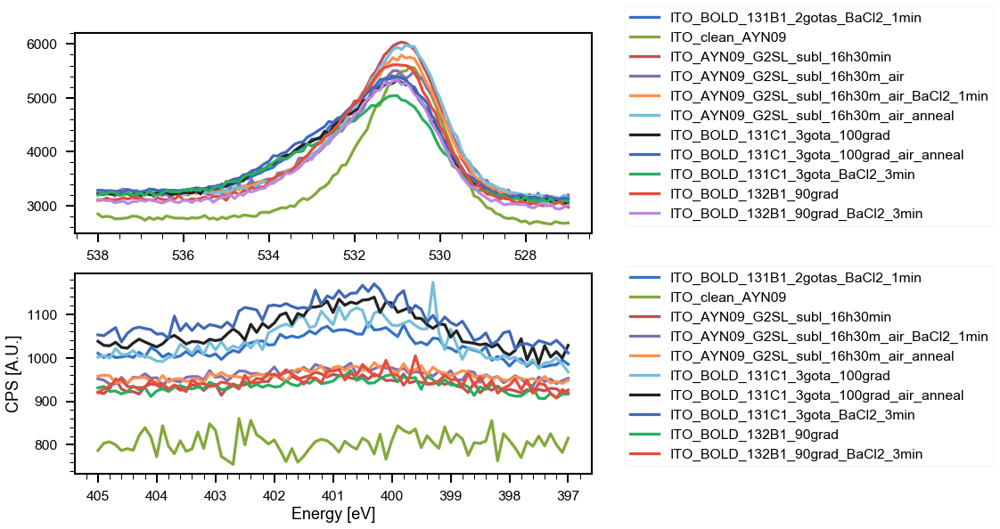

In [472]:
fig, ax = plt.subplots(2)
plot_exps(trimmed_exps[22:], 'O1s', ax=ax[0])
plot_exps(trimmed_exps[22:], 'N1s', ax=ax[1])

## Batch trimming regions

In [375]:
def batch_trimming(experiments: list, regions: list,
                flag_plot: bool = True)->list:
    """Loop over specified regions, locate the experiment with shortest ends
        and trim all spectra to meet those bounds"""

    ### First find shortest spectra on both ends:
    fig, ax = plt.subplots(len(regions), figsize=(8, 8*len(regions)))
    trimmed_exps = deepcopy(experiments)

    for i,r in enumerate(regions):
        rng = []
        for j,xp in enumerate(trimmed_exps):
            try:
                rng.append(len(xp.dfx[r].dropna().energy.values))
            except KeyError: rng.append(10000)

        shorty = np.argmin(rng)
        for j,xp in enumerate(trimmed_exps):
            try:
                trim_spectra(xp, xpRef=trimmed_exps[shorty], region=r, inplace=True)                
            except KeyError: pass

    if flag_plot:
        for i,r in enumerate(regions):
            plot_exps(trimmed_exps, r, ax=ax[i])
            ax[i].set(title=r)

    return trimmed_exps

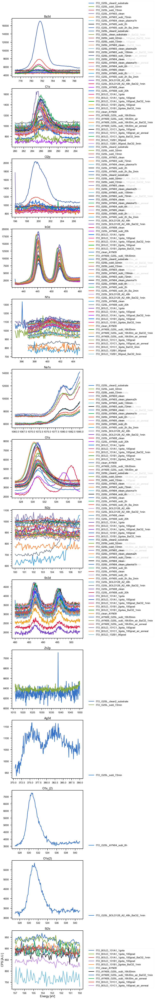

In [376]:
trimmed_exps = batch_trimming(experiments, regions, flag_plot=True)

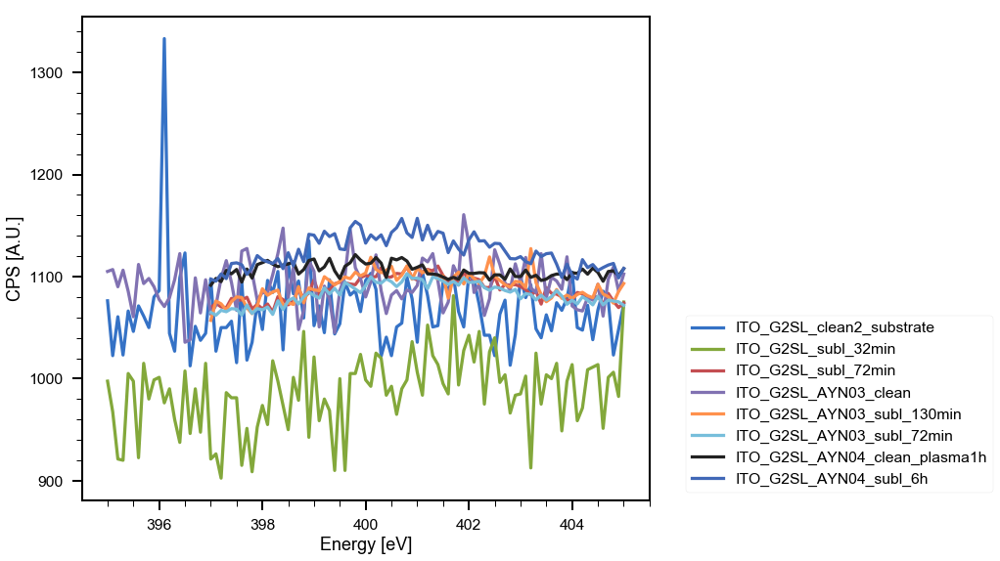

In [371]:
plot_exps(trimmed_exps[:11], 'N1s', )

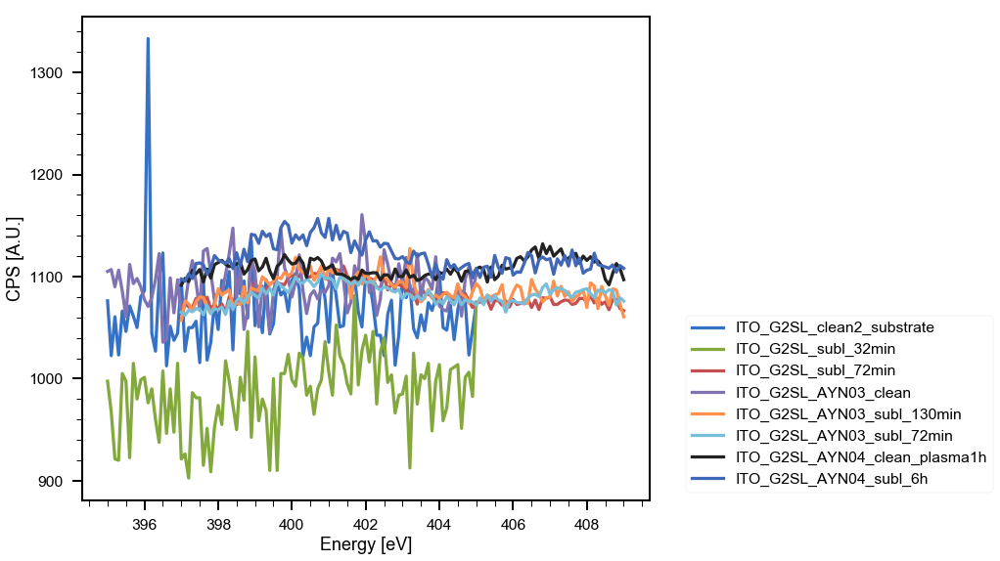

In [372]:
plot_exps(experiments[:11], 'N1s')

## Batch bg subtraction

In [16]:
def get_all_regions(experiments: list)->list:
    allr = []
    for xp in experiments:
        for r in xp.dfx.columns.levels[0].values:
            if ('overview' not in r) and (r not in allr):
                allr.append(r)
    return allr

In [465]:
def subtract_shirley_bg(xp : XPS_experiment, region : str, maxit : int = 10,
                        lb : str = '__nolabel__', offset: float = 0,
                        ax = None, store: bool = True,
                        verbose: bool = False, inplace: bool = False) -> XPS_experiment:
    """Plot region and shirley background. Decorator for shirley_loop function"""
    x, y = xp.dfx[region].dropna().energy.values, xp.dfx[region].dropna().counts.values
    col = plot_region(xp = xp, region = region, lb = lb, ax = ax, offset=offset).get_color()

    find_integration_limits(x, y, flag_plot=verbose, region = region, ax = ax)
    ybg = shirley_loop(x, y, maxit = maxit)

    if ax == None: ax = plt.gca()
    ax.plot(x, ybg + offset, '--', color=col, label=lb);
    #cosmetics_plot(ax = ax)

    dfnew = pd.DataFrame({'energy' : x, 'counts' : y - ybg})

    if inplace:
        xp.dfx[region] = dfnew
        if store:
            xp.dfx[region+'_bg', 'energy'] = pd.Series(x)
            xp.dfx[region+'_bg', 'counts']  = pd.Series(ybg)
        return xp
    else:
        xpNew = deepcopy(xp)
        xpNew.dfx[region] = dfnew
        if store:
            xpNew.dfx[region+'_bg', 'energy'] = pd.Series(x)
            xpNew.dfx[region+'_bg', 'counts']  = pd.Series(ybg)
        return xpNew

def subtract_als_bg (xp : XPS_experiment, region,
                    lb : str = None, ax = None,
                    store: bool = True, inplace: bool = False) -> XPS_experiment:
    """Fit background to asymmetric Least Square Smoothed bg and subtract from data"""

    x = xp.dfx[region].dropna().energy.values
    y = xp.dfx[region].dropna().counts.values
    if ax == None: ax = plt.gca()
    col = plot_region(xp, region, lb=region, ax=ax).get_color()

    ybg = baseline_als(y)
    ax.plot(x, ybg, '--', color=col, label='ALS Baseline')

    dfnew = pd.DataFrame({'energy' : x, 'counts' : y - ybg})

    if inplace:
        xp.dfx[region] = dfnew
        if store:
            xp.dfx[region+'_bg', 'energy'] = pd.Series(x)
            xp.dfx[region+'_bg', 'counts']  = pd.Series(ybg)
        return xp
    else:
        xpNew = deepcopy(xp)
        xpNew.dfx[region] = dfnew
        if store:
            xpNew.dfx[region+'_bg', 'energy'] = pd.Series(x)
            xpNew.dfx[region+'_bg', 'counts']  = pd.Series(ybg)
        return xpNew

def bulk_bg_subtract(experiments : list, regions : list, flag_plot:bool = True, flag_debug:bool = False) -> list:
    """Perform shirley bg subtraction on specified regions from several experiments
    Plot results and store them new list of experiments"""
    bg_exps = deepcopy(experiments)
    
    fig, ax = plt.subplots(len(regions),2, figsize=(18, 8 * len(regions)))
    for i,r in enumerate(regions):
        for j,xp in enumerate(bg_exps):
            if flag_debug:
                print(xp.name, r)
            try:
                xp = subtract_shirley_bg(xp, r, maxit=80, lb=xp.label, ax=ax[i][0], 
                                         offset=500*j, store=True, inplace=True);    # Perform bg subtraction
                plot_region(xp, r, ax=ax[i][1], offset=0*j)

            except AssertionError:
                print('Max iterations exceeded, subtract ALS baseline')
                xp = subtract_als_bg(xp, r, lb=xp.label, ax = ax[i][0],
                                     store=True, inplace=True)
                plot_region(xp, r, ax=ax[i][1], offset=0*j)
                
            except KeyError as e:
                print('KeyError on ', e)
                continue
            
        ax[i][0].set_title(r)
        ax[i][1].set_title('Subtraction result')
            
        ax[i][0].invert_xaxis()
        ax[i][1].invert_xaxis()
        ax[i][1].legend(bbox_to_anchor=(1.05, 0), loc=3)

    fig.tight_layout()
    if not flag_plot: plt.clf(); plt.close()
    return bg_exps

ITO_G2SL_clean2_substrate O1s
ITO_G2SL_clean_substrate O1s
KeyError on  'O1s'
ITO_G2SL_subl_32min O1s
ITO_G2SL_subl_72min O1s
ITO_G2SL_AYN03_clean O1s
ITO_G2SL_AYN03_clean_plasma2h O1s
ITO_G2SL_AYN03_subl_130min O1s
ITO_G2SL_AYN03_subl_72min O1s
ITO_G2SL_AYN04_clean O1s
ITO_G2SL_AYN04_clean_plasma1h O1s
ITO_G2SL_AYN04_subl_6h O1s
ITO_G2SL_clean2_substrate N1s
ITO_G2SL_clean_substrate N1s
KeyError on  'N1s'
ITO_G2SL_subl_32min N1s
ITO_G2SL_subl_72min N1s
ITO_G2SL_AYN03_clean N1s
ITO_G2SL_AYN03_clean_plasma2h N1s
KeyError on  'N1s'
ITO_G2SL_AYN03_subl_130min N1s
ITO_G2SL_AYN03_subl_72min N1s
ITO_G2SL_AYN04_clean N1s
KeyError on  'N1s'
ITO_G2SL_AYN04_clean_plasma1h N1s
ITO_G2SL_AYN04_subl_6h N1s


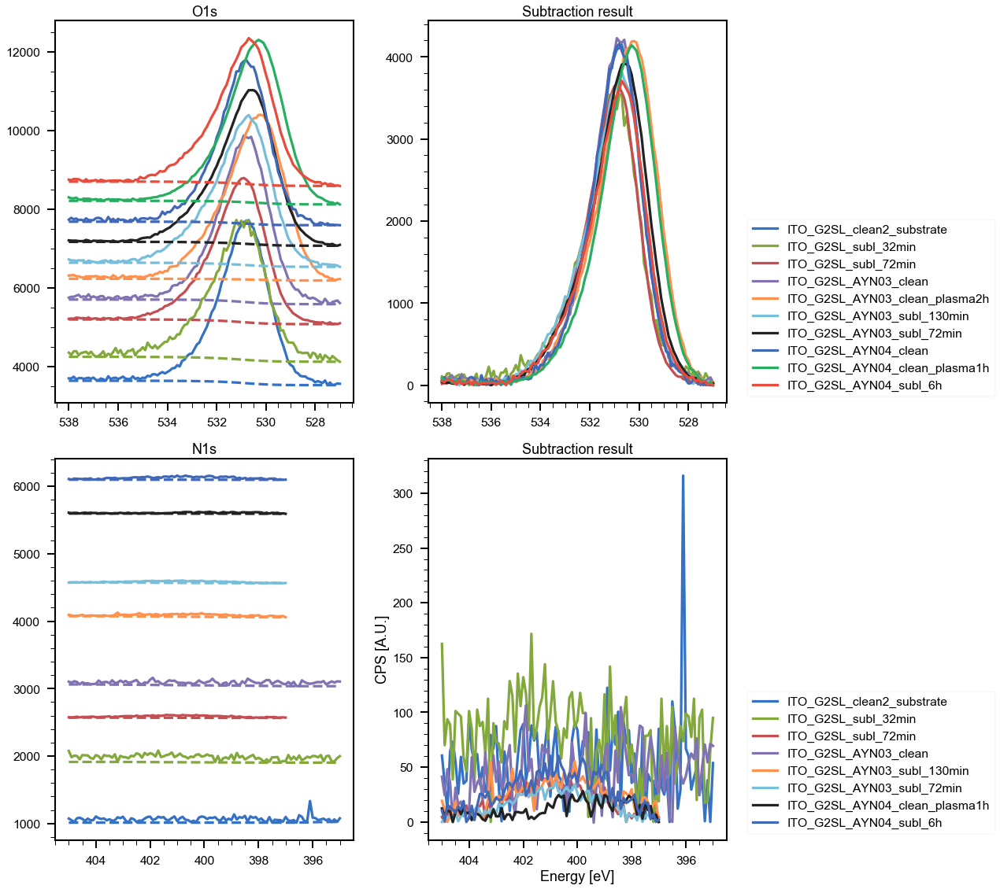

In [466]:
bg = bulk_bg_subtract(trimmed_exps[:11], ['O1s', 'N1s'], flag_plot=True, flag_debug=True)


KeyError on  'Ba3d'
KeyError on  'Ba3d'
KeyError on  'Ba3d'
KeyError on  'Ba3d'
KeyError on  'Ba3d'
KeyError on  'Ba3d'
KeyError on  'Cl2p'
Max iterations exceeded, subtract ALS baseline
KeyError on  'Cl2p'
KeyError on  'Cl2p'
KeyError on  'Cl2p'
KeyError on  'Cl2p'
KeyError on  'Cl2p'
KeyError on  'In3d'
KeyError on  'N1s'
KeyError on  'N1s'
KeyError on  'N1s'
KeyError on  'N1s'
Max iterations exceeded, subtract ALS baseline
KeyError on  'Na1s'
KeyError on  'Na1s'
Max iterations exceeded, subtract ALS baseline
KeyError on  'Na1s'
KeyError on  'Na1s'
KeyError on  'Na1s'
Max iterations exceeded, subtract ALS baseline
KeyError on  'Na1s'
Max iterations exceeded, subtract ALS baseline
KeyError on  'Na1s'
KeyError on  'Na1s'
KeyError on  'Na1s'
KeyError on  'Na1s'
KeyError on  'Na1s'
KeyError on  'O1s'
KeyError on  'Si2p'
KeyError on  'Si2p'
KeyError on  'Si2p'
KeyError on  'Si2p'
KeyError on  'Sn3d'
KeyError on  'Sn3d'
KeyError on  'Zn2p'
KeyError on  'Zn2p'
Max iterations exceeded, subtr

<Figure size 748.8x655.2 with 0 Axes>

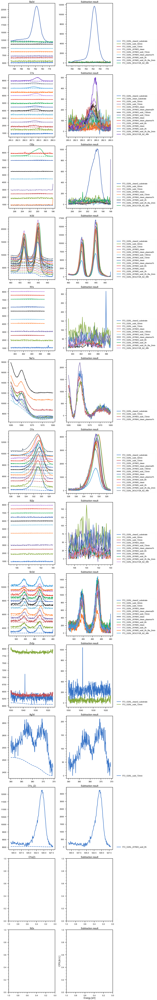

<Figure size 748.8x655.2 with 0 Axes>

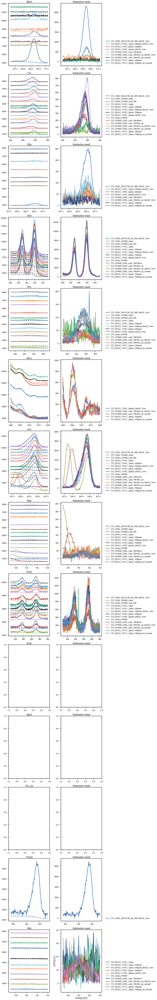

<Figure size 748.8x655.2 with 0 Axes>

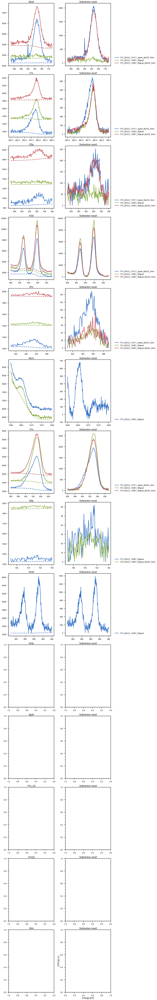

In [467]:
nfigs = len(experiments) // 15 + int((len(experiments) % 15) != 0)
bg_set = []
for n in range(nfigs):
    plt.figure()
    bg_set.append(bulk_bg_subtract(trimmed_exps[15*n:15*(n+1)], regions, flag_plot=True))
bg_exps = [xp for bgs in bg_set for xp in bgs]

In [538]:
bg_exps = region_2bg_subtract(bg_exps, region='In3d', xlim=449.6, flag_plot=False)


KeyError in 'In3d'


## Scale to In 3d

KeyError in 'In3d'


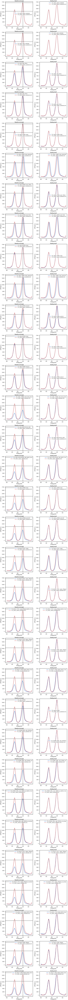

In [703]:
scaled = scale_and_plot_spectra(bg_exps, region='In3d')

## Store progress

In [705]:
store_results(bg_exps, scaled)

Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean2_substrate
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean_substrate
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_32min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_72min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean_plasma2h
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_subl_130min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G

# Integrate regions

In [533]:
def bulk_integrate_areas(experiments: list, regions: list, asf: dict) ->list:

    for i,r in enumerate(regions):
        integrateRegions(experiments, region=r, asf=asf)#, indRef=indRefs[i])

In [832]:
regions = get_all_regions(bg_exps)
regions

['Ba3d',
 'C1s',
 'Cl2p',
 'In3d',
 'N1s',
 'Na1s',
 'O1s',
 'Si2p',
 'Sn3d',
 'Zn2p',
 'Ba3d_bg',
 'C1s_bg',
 'Cl2p_bg',
 'In3d_bg',
 'N1s_bg',
 'Na1s_bg',
 'O1s_bg',
 'Si2p_bg',
 'Sn3d_bg',
 'Zn2p_bg',
 'Ag3d',
 'Ag3d_bg',
 'O1s_(2)',
 'O1s_(2)_bg',
 'O1s(2)',
 'O1s(2)_bg',
 'Si2s',
 'Si2s_bg']

In [833]:
newregs = []
for r in regions:
    if ('(' not in r) and ('_bg' not in r):
        newregs.append(r)
newregs

['Ba3d',
 'C1s',
 'Cl2p',
 'In3d',
 'N1s',
 'Na1s',
 'O1s',
 'Si2p',
 'Sn3d',
 'Zn2p',
 'Ag3d',
 'Si2s']

In [531]:
asf = dict({'C1s' : 0.296, 'O1s' : 0.711, 'O1s_sub' : 0.711, 'N1s' : 0.477, 'Ba3d' : 7.49, 'Ba_3d_5/2' : 7.49, 'Ba_3d_3/2' : 5.20,
            'Br3p' : 1.054, 'Cu_2p' : 5.321, 'Ba4d': 2.35, 'Na1s' : 1.685, 'Cl2s' : 0.37, 'Ru3d' : 4.273,
           'In3d' : 4.359, 'Sn3d' : 4.725, 'Cl2p' : 0.891, 'Si2p': 0.339, 'Ag3d': 5.987, 'Zn2p': 3.576})


In [834]:
asfScof = {}
for r in newregs:
    asfScof.update(search_asf(r))

asfScof['Ba3d'] = search_asf('Ba3d5/2')['Ba3d5/2']
asfScof['O1s_sub'] = asfScof['O1s']

In [835]:
asfScof

{'Ba3d': 5.832957110609481,
 'C1s': 0.2257336343115124,
 'Cl2p': 0.5158013544018059,
 'In3d': 5.088036117381489,
 'N1s': 0.4063205417607223,
 'Na1s': 1.9232505643340858,
 'O1s': 0.6613995485327314,
 'Si2p': 0.18442437923250563,
 'Sn3d': 5.654627539503386,
 'Zn2p': 6.483069977426636,
 'Ag3d': 4.072234762979684,
 'Si2s': 0.21557562076749434,
 'O1s_sub': 0.6613995485327314}

In [535]:
for xp in bg_exps:
    xp.area = {}

In [630]:
def guess_xpRef(exps:list , region: str):
    """Guess the best resolved spectrum  in the list as the highest peak in the region
    (use after pre-processing)"""
    ymx = []
    for xp in exps:
        try:
            ymx.append(xp.dfx[region].counts.max())
        except KeyError:
            ymx.append(0)
    
    yarr = np.array(ymx)
    yarr.sort()
    yarr = yarr[yarr > 0]

    if yarr[-1] > np.average(yarr) + 2*np.std(yarr):
        print('Noisy peak')
        return(np.where(ymx == yarr[-2])[0][0])
    else:
        return np.argmax(np.array(ymx))

In [668]:
guess_xpRef(bg_exps, 'N1s')

Noisy peak


28

Noisy peak
'Ba3d' region does not exist in ITO_G2SL_clean_substrate
'Ba3d' region does not exist in ITO_G2SL_AYN03_clean_plasma2h
'Ba3d' region does not exist in ITO_G2SL_AYN03_subl_130min
'Ba3d' region does not exist in ITO_G2SL_AYN04_clean
'Ba3d' region does not exist in ITO_G2SL_AYN04_subl_6h
'Ba3d' region does not exist in ITO_G2SL_AYN05_clean
'Ba3d' region does not exist in ITO_G2SL_AYN08_clean
'Ba3d' region does not exist in ITO_G2SL_AYN08_subl_20h
'Ba3d' region does not exist in ITO_BOLD_131A1_1gota
'Ba3d' region does not exist in ITO_BOLD_131A1_1gota_100grad
'Ba3d' region does not exist in ITO_clean_AYN09
'Ba3d' region does not exist in ITO_AYN09_G2SL_subl_16h30m_air
Noisy peak
Noisy peak
'Cl2p' region does not exist in ITO_G2SL_clean_substrate
'Cl2p' region does not exist in ITO_G2SL_AYN03_clean_plasma2h
'Cl2p' region does not exist in ITO_G2SL_AYN03_subl_130min
'Cl2p' region does not exist in ITO_G2SL_AYN04_clean
'Cl2p' region does not exist in ITO_G2SL_AYN04_subl_6h
'Cl2p' r

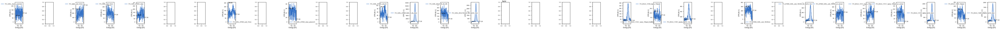

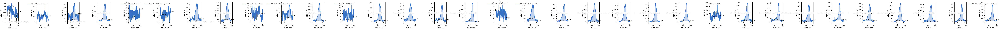

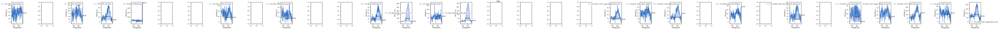

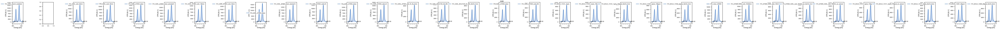

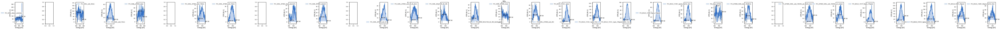

...

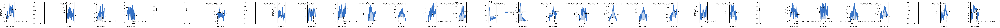

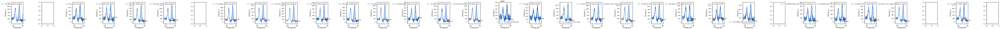

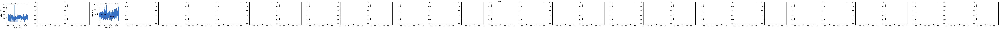

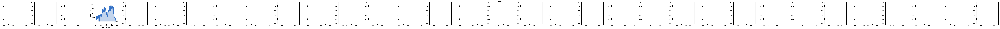

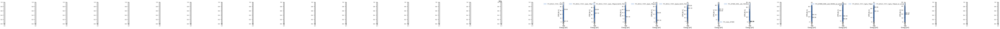

In [670]:
bulk_integrate_areas(bg_exps, regions, asf)

# O 1s subtraction

In [979]:
globpath = '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/**/'

files = glob.glob(globpath+'/*.sxy', recursive=True)
files.sort()

scaled = [read_processed_xp(path=f) for f in files]

[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean2_substrate.sxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean_substrate.sxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_32min.sxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_72min.sxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean.sxy.ft', returning empty fit dict
[Errno 2] No

In [980]:
cleans = [xp for xp in scaled if 'clean' in xp.name ]

namescl = {i: xp.name for i, xp in enumerate(cleans)}
namescl

{0: 'ITO_clean_AYN09'}

In [718]:
g2 = [xp for xp in scaled if 'clean' not in xp.name]

In [704]:
dnames = {i: xp.name for i, xp in enumerate(scaled)}
dnames

{0: 'ITO_G2SL_clean2_substrate',
 1: 'ITO_G2SL_clean_substrate',
 2: 'ITO_G2SL_subl_32min',
 3: 'ITO_G2SL_subl_72min',
 4: 'ITO_G2SL_AYN03_clean',
 5: 'ITO_G2SL_AYN03_clean_plasma2h',
 6: 'ITO_G2SL_AYN03_subl_130min',
 7: 'ITO_G2SL_AYN03_subl_72min',
 8: 'ITO_G2SL_AYN04_clean',
 9: 'ITO_G2SL_AYN04_clean_plasma1h',
 10: 'ITO_G2SL_AYN04_subl_6h',
 11: 'ITO_G2SL_AYN05_clean',
 12: 'ITO_G2SL_AYN05_subl_2h',
 13: 'ITO_G2SL_AYN05_subl_2h_Ba_2min',
 14: 'ITO_G2SL_BOLD128_A2_48h',
 15: 'ITO_G2SL_BOLD128_A2_48h_BaCl2_1min',
 16: 'ITO_G2SL_AYN08_clean',
 17: 'ITO_G2SL_AYN08_subl_20h',
 18: 'ITO_BOLD_131A1_1gota',
 19: 'ITO_BOLD_131A1_1gota_100grad',
 20: 'ITO_BOLD_131A1_1gota_100grad_BaCl2_1min',
 21: 'ITO_BOLD_131B1_2gota_100grad',
 22: 'ITO_BOLD_131B1_2gotas_BaCl2_1min',
 23: 'ITO_clean_AYN09',
 24: 'ITO_AYN09_G2SL_subl_16h30min',
 25: 'ITO_AYN09_G2SL_subl_16h30m_air',
 26: 'ITO_AYN09_G2SL_subl_16h30m_air_BaCl2_1min',
 27: 'ITO_AYN09_G2SL_subl_16h30m_air_anneal',
 28: 'ITO_BOLD_131C1_3gota_100

In [720]:
g2n = {i: xp.name for i, xp in enumerate(g2)}
g2n

{0: 'ITO_G2SL_subl_32min',
 1: 'ITO_G2SL_subl_72min',
 2: 'ITO_G2SL_AYN03_subl_130min',
 3: 'ITO_G2SL_AYN03_subl_72min',
 4: 'ITO_G2SL_AYN04_subl_6h',
 5: 'ITO_G2SL_AYN05_subl_2h',
 6: 'ITO_G2SL_AYN05_subl_2h_Ba_2min',
 7: 'ITO_G2SL_BOLD128_A2_48h',
 8: 'ITO_G2SL_BOLD128_A2_48h_BaCl2_1min',
 9: 'ITO_G2SL_AYN08_subl_20h',
 10: 'ITO_BOLD_131A1_1gota',
 11: 'ITO_BOLD_131A1_1gota_100grad',
 12: 'ITO_BOLD_131A1_1gota_100grad_BaCl2_1min',
 13: 'ITO_BOLD_131B1_2gota_100grad',
 14: 'ITO_BOLD_131B1_2gotas_BaCl2_1min',
 15: 'ITO_AYN09_G2SL_subl_16h30min',
 16: 'ITO_AYN09_G2SL_subl_16h30m_air',
 17: 'ITO_AYN09_G2SL_subl_16h30m_air_BaCl2_1min',
 18: 'ITO_AYN09_G2SL_subl_16h30m_air_anneal',
 19: 'ITO_BOLD_131C1_3gota_100grad',
 20: 'ITO_BOLD_131C1_3gota_100grad_air_anneal',
 21: 'ITO_BOLD_131C1_3gota_BaCl2_3min',
 22: 'ITO_BOLD_132B1_90grad',
 23: 'ITO_BOLD_132B1_90grad_BaCl2_3min'}

In [735]:
len([cleans[6]] + g2)

25

## Scale all O 1s

In [753]:
rego = 'O1s'

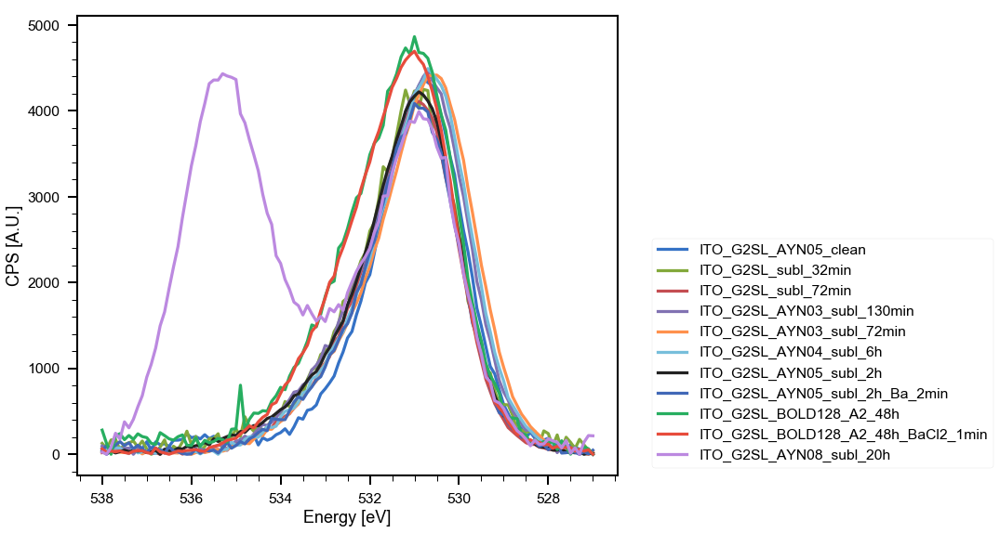

In [741]:
plot_exps([cleans[6]] + g2[:10], 'O1s')

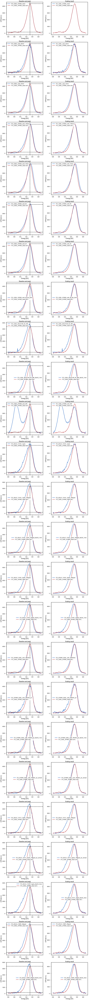

In [740]:
scalo = scale_and_plot_spectra([cleans[6]] + g2, indRef=0, region=rego)

## Subtract clean exp, save result in new region O1s_sub

In [800]:
def subtract_ref_region(xp : XPS_experiment, xpRef: XPS_experiment, region: str, inplace : bool = False):
    """Subtract the counts in a region in xpRef from xp, useful to account for clean substrate contributions"""

    df, dfRef = xp.dfx[region].dropna(), xpRef.dfx[region].dropna()
    y_sub = df.counts - dfRef.counts
    if inplace:
        xp.dfx[region+'_sub', 'energy'] = pd.Series(xp.dfx[region].energy)
        xp.dfx[region+'_sub', 'counts']  = pd.Series(y_sub)
        return xp
    else:
        xpNew = deepcopy(xp)
        xpNew.dfx[region+'_sub', 'energy'] = pd.Series(xp.dfx[region].energy)
        xpNew.dfx[region+'_sub', 'counts']  = pd.Series(y_sub)
        return xpNew

In [801]:
subo = []
for xp in scalo[1:]:
    xpsub = subtract_ref_region(xp, scalo[0], rego)
    subo.append(xpsub)

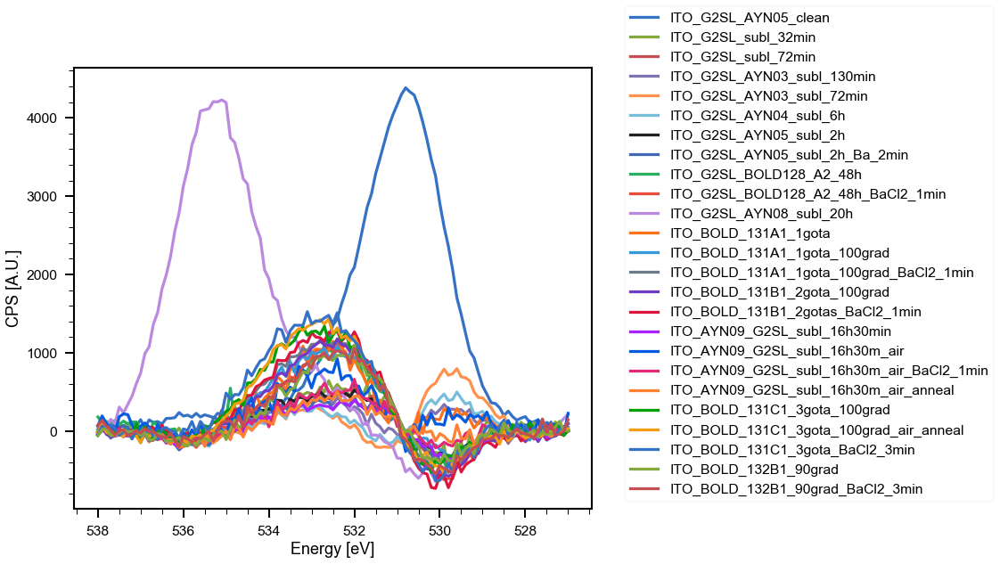

In [802]:
plot_region(cleans[6], 'O1s')
plot_exps(subo, 'O1s_sub')
plt.gca().invert_xaxis()

In [803]:
g2sub = {i: xp.name for i, xp in enumerate(subo)}

ind_hole = search_dnames('ITO_G2SL_AYN08_subl_20h',g2sub) # Remove this experiment (hole through ITO)
subo.pop(ind_hole);

## Filters

### Keep only right tail of the peak

In [805]:
x = cleans[6].dfx['O1s'].energy.dropna()
y = cleans[6].dfx['O1s'].counts.dropna()

epeak = x[np.argmax(y)]
for xp in subo:
    crop_spectrum(xp, region='O1s_sub', edw=epeak, inplace=True)

In [981]:
def filter_he_tail(subo: list, cleans: list, cleanRef: int = 0):
    """Crop spectra up to the peak of the original clean"""
    x = cleans[cleanRef].dfx['O1s'].energy.dropna()
    y = cleans[cleanRef].dfx['O1s'].counts.dropna()

    epeak = x[np.argmax(y)]
    for xp in subo:
        crop_spectrum(xp, region='O1s_sub', edw=epeak, inplace=True)     

In [982]:
def subtract_ito_ox(exps: list, cleanRef: int = 0):
    
    ### Sort experiments in clean and coated
    cleans = [xp for xp in exps if 'clean' in xp.name ]
    g2 = [xp for xp in exps if 'clean' not in xp.name]
    
    ### Scale to O1s
    rego = 'O1s'
    scalo = scale_and_plot_spectra([cleans[cleanRef]] + g2, indRef=0, region=rego)
    
    ### Subtract clean (ITO) component
    subo = []
    for xp in scalo[1:]:
        xpsub = subtract_ref_region(xp, scalo[0], rego)
        subo.append(xpsub)
    
    ### Filter and background subtraction
    filter_he_tail(subo, cleans, cleanRef)
    subo = region_bg_subtract(subo, 'O1s_sub')
    
    return subo

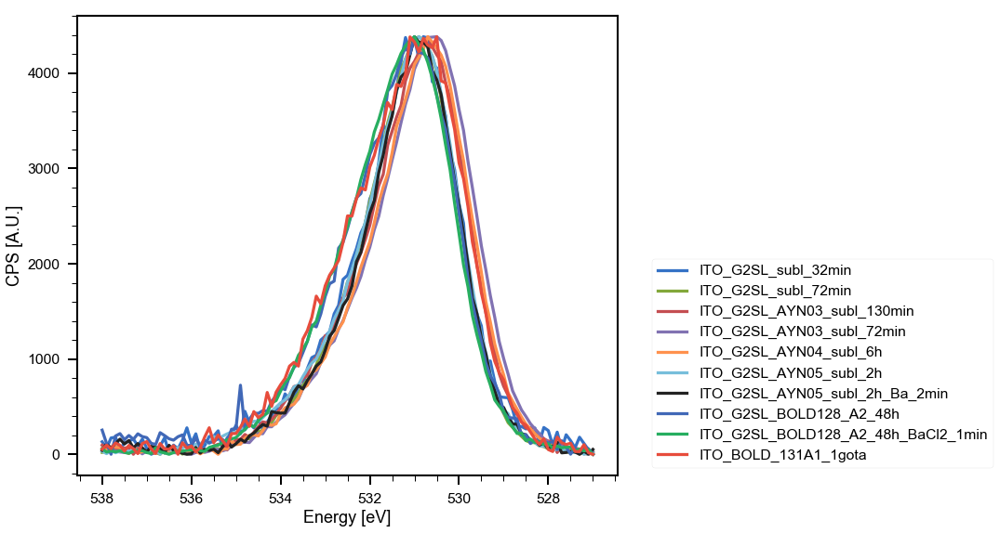

In [808]:
plot_exps(subo[:10], 'O1s')

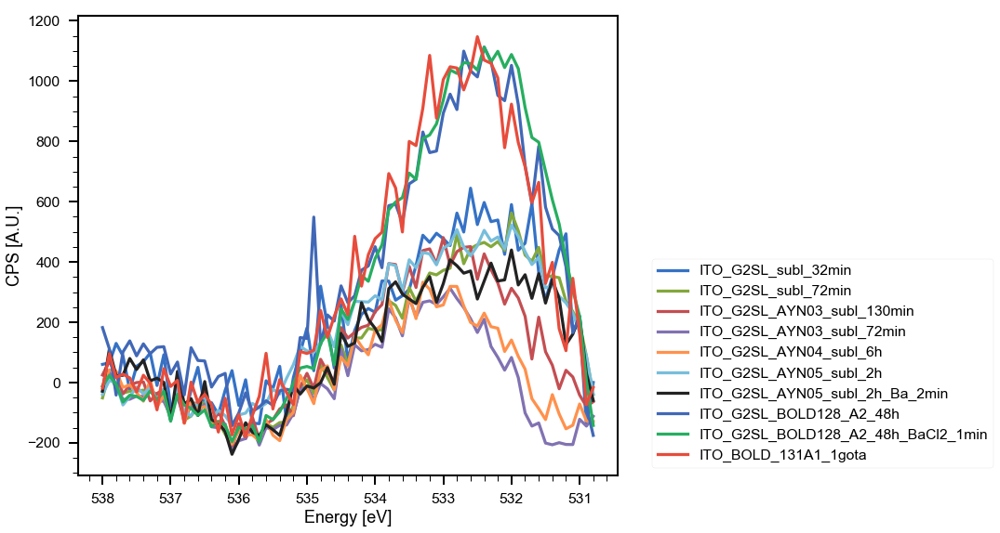

In [807]:
plot_exps(subo[:10], 'O1s_sub')

### Subtract background (offset over 0)

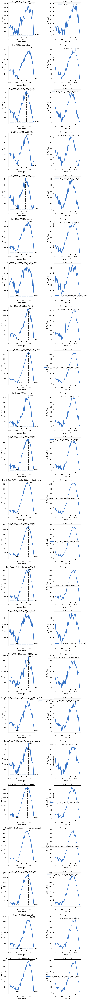

In [836]:
subo = region_bg_subtract(subo, 'O1s_sub')

## Integrate region

[2234.384996032672,
 1836.7764985349972,
 1715.5965352096384,
 1327.9382680725694,
 1283.6643317959708,
 1914.3838195568753,
 1800.6766107707717,
 3394.728510939452,
 3481.2016597316733,
 3220.135237754287,
 3228.7405597711318,
 3769.5520283031237,
 3782.0343640691863,
 4372.711055201652,
 1558.9469340253654,
 3121.124238050544,
 2060.431653726689,
 1648.6857873266893,
 4465.321310502391,
 4505.849097893736,
 4952.310531828093,
 2914.562364310213,
 3343.2655477563626]

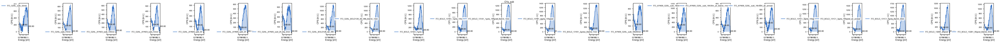

In [837]:
integrateRegions(subo, 'O1s_sub', asf)

## Full method 

# Stoichiometry results

In [792]:
ayns = [xp for xp in subo if 'AYN' in xp.name]
bolds = [xp for xp in subo if 'BOLD' in xp.name]
bas = [xp for xp in subo if '_Ba' in xp.name]

In [838]:
num, denom = (('N1s', 'C1s', 'C1s', 'N1s', 'C1s'), ('O1s_sub', 'N1s', 'O1s_sub', 'Si2p', 'Si2p'))
display_stoichiometry(subo,  num=num, denom=denom, )

In [789]:
num, denom = (('N1s', 'C1s', 'C1s', 'N1s', 'C1s'), ('O1s_sub', 'N1s', 'O1s_sub', 'Si2p', 'Si2p'))
display_stoichiometry(ayns,  num=num, denom=denom, )

In [790]:
num, denom = (('N1s', 'C1s', 'C1s', 'N1s', 'C1s'), ('O1s_sub', 'N1s', 'O1s_sub', 'Si2p', 'Si2p'))
display_stoichiometry(bolds,  num=num, denom=denom, )

In [796]:
for xp in bas:
    xp.area['G2'] = xp.area['N1s'] / 4

In [797]:
num, denom = ('Ba3d', 'Ba3d'), ('G2', 'Cl2p')
display_stoichiometry(bas,  num=num, denom=denom, )

## Store final results

Leave original .uxy untouched, store experiments with subtracted O1s as .sxy

In [960]:
store_results(bg_exps, subo)

Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean2_substrate
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean_substrate
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_32min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_72min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean_plasma2h
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_subl_130min
Stored  /Users/pabloherrero/sabat/xps_spectra/ITO_G

# Sort coverages

In [906]:
files

['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_clean2_substrate.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_32min.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc/20220822_ITO_G2SL_subl_72min.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_clean_plasma2h.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_subl_130min.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc/20220823_ITO_G2SL_AYN03_subl_72min.sxy',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/

In [961]:
direc = []
for f in files:
#     expdir = os.path.split(f)[0].replace('/proc', '')
    direc.append(os.path.split(f)[0])
direc

['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
 '/Users/pabloherrero/

In [962]:
fgroups = [[x] * direc.count(x) for x in set(direc) if direc.count(x) > 1]
fgroups

[['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc'],
 ['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc'],
 ['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
  '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc'],
 ['/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
  '/Users/pabloher

In [963]:
set(direc)

{'/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_22_ITO_G2SL_subl72min_AYN02/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_23_ITO_G2SL_subl130min_AYN03/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_31_ITO_G2SL_BOLD_128_A2_48h/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_07_ITO_quartz_hole_G2SL_AYN_08/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_08_BOLD131_A1/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_08_BOLD131_A1/proc/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_14_BOLD131_B1/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_15_AYN_09/proc',
 '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_09_22_BOLD131_C

In [964]:
fullset = []
for fgroup in set(direc):
    gfiles = glob.glob(fgroup+'/*.uxy')
    xpgroup = [read_processed_xp(gf) for gf in gfiles]
    fullset.append(xpgroup)
        

[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc/20220826_ITO_G2SL_AYN05_subl_2h_Ba_2min.uxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc/20220825_ITO_G2SL_AYN05_subl_2h.uxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_25_ITO_G2SL_subl2h_AYN_05/proc/20220825_ITO_G2SL_AYN05_clean.uxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc/20220824_ITO_G2SL_AYN04_clean_plasma1h.uxy.ft', returning empty fit dict
[Errno 2] No such file or directory: '/Users/pabloherrero/sabat/xps_spectra/ITO_G2SL/tests/2022_08_24_ITO_G2SL_subl6h_AYN_04/proc/20220825_ITO_G2SL_AYN04_subl_6h.uxy.ft', returning empty fit dict
[Errno 

In [965]:
for xpgroup in fullset:
    print([xp.name for xp in xpgroup])

['ITO_G2SL_AYN05_subl_2h_Ba_2min', 'ITO_G2SL_AYN05_subl_2h', 'ITO_G2SL_AYN05_clean']
['ITO_G2SL_AYN04_clean_plasma1h', 'ITO_G2SL_AYN04_subl_6h', 'ITO_G2SL_AYN04_clean']
['ITO_G2SL_clean_substrate', 'ITO_G2SL_subl_32min', 'ITO_G2SL_clean2_substrate', 'ITO_G2SL_subl_72min']
['ITO_G2SL_AYN03_clean', 'ITO_G2SL_AYN03_subl_130min', 'ITO_G2SL_AYN03_subl_72min', 'ITO_G2SL_AYN03_clean_plasma2h']
['ITO_G2SL_BOLD128_A2_48h', 'ITO_G2SL_BOLD128_A2_48h_BaCl2_1min']
['ITO_BOLD_131A1_1gota', 'ITO_BOLD_131A1_1gota_100grad', 'ITO_BOLD_131A1_1gota_100grad_BaCl2_1min']
['ITO_BOLD_131C1_3gota_BaCl2_3min', 'ITO_BOLD_131C1_3gota_100grad_air_anneal', 'ITO_BOLD_131C1_3gota_100grad']
['BOLD 131 A1', 'BaCl$_2$/ BOLD 131 A1']
['ITO_BOLD_131B1_2gotas_BaCl2_1min', 'ITO_BOLD_131B1_2gota_100grad']
['ITO_BOLD_132B1_90grad', 'ITO_BOLD_132B1_90grad_BaCl2_3min']
['ITO_AYN09_G2SL_subl_16h30m_air_BaCl2_1min', 'ITO_AYN09_G2SL_subl_16h30min', 'ITO_AYN09_G2SL_subl_16h30m_air', 'ITO_clean_AYN09', 'ITO_AYN09_G2SL_subl_16h30m_ai

##### Check number of experiments in each group (useful for testing)

In [912]:
for xpgroup in fullset:
    print(len(xpgroup))

3
3
3
4
2
3
3
2
2
2
5
2


In [915]:
for x in set(direc):
    print(direc.count(x))

3
3
3
4
2
3
3
2
2
2
5
2


## Find reference experiment (clean substrate)

In [966]:
[xp.name for xp in fullset[3]]

['ITO_G2SL_AYN03_clean',
 'ITO_G2SL_AYN03_subl_130min',
 'ITO_G2SL_AYN03_subl_72min',
 'ITO_G2SL_AYN03_clean_plasma2h']

In [919]:
guess_clean_xp(fullset[3])

Too many clean experiments!


In [921]:
[xp.name for xp in fullset[2]]

['ITO_G2SL_subl_32min', 'ITO_G2SL_clean2_substrate', 'ITO_G2SL_subl_72min']

In [922]:
guess_clean_xp(fullset[2])

[0, 2, 1]

In [937]:
def guess_clean_xp(exp_set):
    lref = []
    li = []
    for i, xp in enumerate(exp_set):
        if 'clean' in xp.name: lref.append(i)
        else: li.append(i)
    if len(lref) == 1:
        inds = li + lref
        return inds
    elif len(lref) < 1:
        print('Did not find clean experiments in this set!')
        raise TypeError
    else:
        print('Too many clean experiments!')
        raise ValueError

In [967]:
for group in fullset:
    try:
        inds = [guess_clean_xp(group)]
    except ValueError: continue
    except TypeError: continue
    
    arrange_coverages(group, inds, r_ml=1.1,
                      region='In3d', mfp=3.05, takeoff=10)

Too many clean experiments!
Too many clean experiments!
Too many clean experiments!
Did not find clean experiments in this set!
Did not find clean experiments in this set!
Did not find clean experiments in this set!
Did not find clean experiments in this set!
Did not find clean experiments in this set!
Did not find clean experiments in this set!


##### Since BOLD samples do not have a reference, their coverage is not calculated

## Take common clean as reference for BOLD samples

In [973]:
flat_set = [xp for group in fullset for xp in group]

In [974]:
bolds = [xp for xp in flat_set if 'BOLD' in xp.name]

In [941]:
[xp.name for xp in bolds]

['ITO_G2SL_BOLD128_A2_48h',
 'ITO_G2SL_BOLD128_A2_48h_BaCl2_1min',
 'ITO_BOLD_131A1_1gota',
 'ITO_BOLD_131A1_1gota_100grad',
 'ITO_BOLD_131A1_1gota_100grad_BaCl2_1min',
 'ITO_BOLD_131C1_3gota_BaCl2_3min',
 'ITO_BOLD_131C1_3gota_100grad_air_anneal',
 'ITO_BOLD_131C1_3gota_100grad',
 'BOLD 131 A1',
 'BaCl$_2$/ BOLD 131 A1',
 'ITO_BOLD_131B1_2gotas_BaCl2_1min',
 'ITO_BOLD_131B1_2gota_100grad',
 'ITO_BOLD_132B1_90grad',
 'ITO_BOLD_132B1_90grad_BaCl2_3min']

In [975]:
indBolds = [[i for i in range(len(bolds)+1)]]
indBolds

[[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]]

In [976]:
arrange_coverages(bolds + [cleans[6]], indBolds, r_ml=1.1,
                  region='In3d', mfp=3.05, takeoff=10)

matrix([[1.00290332, 0.03341237],
        [1.51762881, 0.03540065],
        [1.60890046, 0.03578094],
        [1.3951761 , 0.03490389],
        [1.67002341, 0.03604047],
        [2.2936899 , 0.03892281],
        [1.94422064, 0.03725409],
        [1.92927002, 0.03718579],
        [2.21549418, 0.0178774 ],
        [1.97989813, 0.01735825],
        [1.71117651, 0.03621744],
        [1.51665103, 0.03539662],
        [1.41848817, 0.03499729],
        [1.70404302, 0.03618664]])

## Plot coverages obtained so far

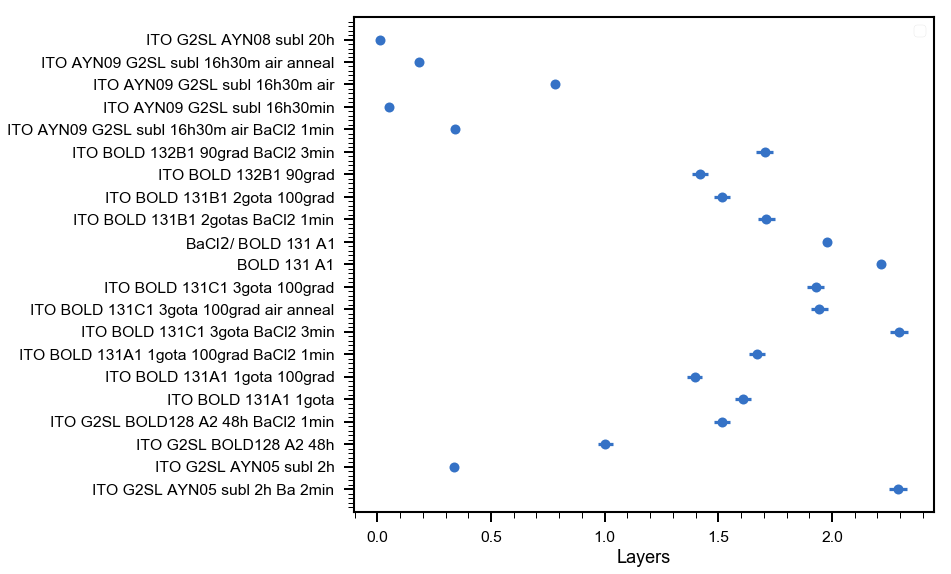

In [977]:
plot_coverages(flat_set)

# Test scripts